In [35]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [36]:
df  = pd.read_csv('CustomerData.csv')
df

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,C19186,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6
8946,C19187,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,NaN,0.000000,6
8947,C19188,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6
8948,C19189,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6


- Balance
- Balance Frequency
- Purchases
- One-off Purchases : การซื้อแบบครั้งเดียว
- Installment Purchases  : การซื้อแบบผ่อนชำระ 
- Cash Advance  : การเบิกเงินสดล่วงหน้า โดยเป็นการยืมจากบัตรเครดิต
- Purchases Frequency : ความถี่หรือจำนวนครั้งที่ทำการซื้อ
- One-off Purchases Frequency 
- Purchases Installments Frequency
- Cash Advance Frequency
- Cash Advance TRX : TRX (tron) เครือข่าย blockchain cryto 
- Purchases TRX 
- Credit Limit
- Payments
- Minimum Payments
- PRC Full payment : PRC ( Proceed Realisation Certificate ) is the authentication/verification from the processing bank that remittance has been received and processed from an overseas arrangement.
- Tenure : การครอบครองทรัพย์สิน

In [37]:
# find sum of missing value in each attributes 
#   - CREDIT_LIMIT = 1
#   - MINIMUM_PAYMENT = 313

df.isnull().sum()

CUST_ID                               0
BALANCE                               0
BALANCE_FREQUENCY                     0
PURCHASES                             0
ONEOFF_PURCHASES                      0
INSTALLMENTS_PURCHASES                0
CASH_ADVANCE                          0
PURCHASES_FREQUENCY                   0
ONEOFF_PURCHASES_FREQUENCY            0
PURCHASES_INSTALLMENTS_FREQUENCY      0
CASH_ADVANCE_FREQUENCY                0
CASH_ADVANCE_TRX                      0
PURCHASES_TRX                         0
CREDIT_LIMIT                          1
PAYMENTS                              0
MINIMUM_PAYMENTS                    313
PRC_FULL_PAYMENT                      0
TENURE                                0
dtype: int64

In [38]:
# clear missing value by pandas.Dataframe.dropna
df_clearMissing = df.dropna(axis = 0, how = 'any', thresh = None, subset = None, inplace = False)
df_clearMissing

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12
5,C10006,1809.828751,1.000000,1333.28,0.00,1333.28,0.000000,0.666667,0.000000,0.583333,0.000000,0,8,1800.0,1400.057770,2407.246035,0.000000,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8943,C19184,5.871712,0.500000,20.90,20.90,0.00,0.000000,0.166667,0.166667,0.000000,0.000000,0,1,500.0,58.644883,43.473717,0.000000,6
8945,C19186,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6
8947,C19188,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6
8948,C19189,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6


In [39]:
# delete customer ID (CUST_ID) >> it is individual data for each customer
df_dropCol = df_clearMissing.drop(columns="CUST_ID")
df_dropCol

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12
5,1809.828751,1.000000,1333.28,0.00,1333.28,0.000000,0.666667,0.000000,0.583333,0.000000,0,8,1800.0,1400.057770,2407.246035,0.000000,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8943,5.871712,0.500000,20.90,20.90,0.00,0.000000,0.166667,0.166667,0.000000,0.000000,0,1,500.0,58.644883,43.473717,0.000000,6
8945,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6
8947,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6
8948,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6


In [40]:
df_dropCol.describe()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
count,8636.000000,8636.000000,8636.000000,8636.000000,8636.000000,8636.000000,8636.000000,8636.000000,8636.000000,8636.000000,8636.000000,8636.000000,8636.000000,8636.000000,8636.000000,8636.000000,8636.000000
mean,1601.224893,0.895035,1025.433874,604.901438,420.843533,994.175523,0.496000,0.205909,0.368820,0.137604,3.313918,15.033233,4522.091030,1784.478099,864.304943,0.159304,11.534391
std,2095.571300,0.207697,2167.107984,1684.307803,917.245182,2121.458303,0.401273,0.300054,0.398093,0.201791,6.912506,25.180468,3659.240379,2909.810090,2372.566350,0.296271,1.310984
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.049513,0.019163,0.000000,6.000000
25%,148.095189,0.909091,43.367500,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,418.559237,169.163545,0.000000,12.000000
50%,916.855459,1.000000,375.405000,44.995000,94.785000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,896.675701,312.452292,0.000000,12.000000
75%,2105.195853,1.000000,1145.980000,599.100000,484.147500,1132.385490,0.916667,0.333333,0.750000,0.250000,4.000000,18.000000,6500.000000,1951.142090,825.496463,0.166667,12.000000
max,19043.138560,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000


In [41]:
df_dropCol.columns

Index(['BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES', 'ONEOFF_PURCHASES',
       'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE', 'PURCHASES_FREQUENCY',
       'ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY',
       'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE_TRX', 'PURCHASES_TRX',
       'CREDIT_LIMIT', 'PAYMENTS', 'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT',
       'TENURE'],
      dtype='object')

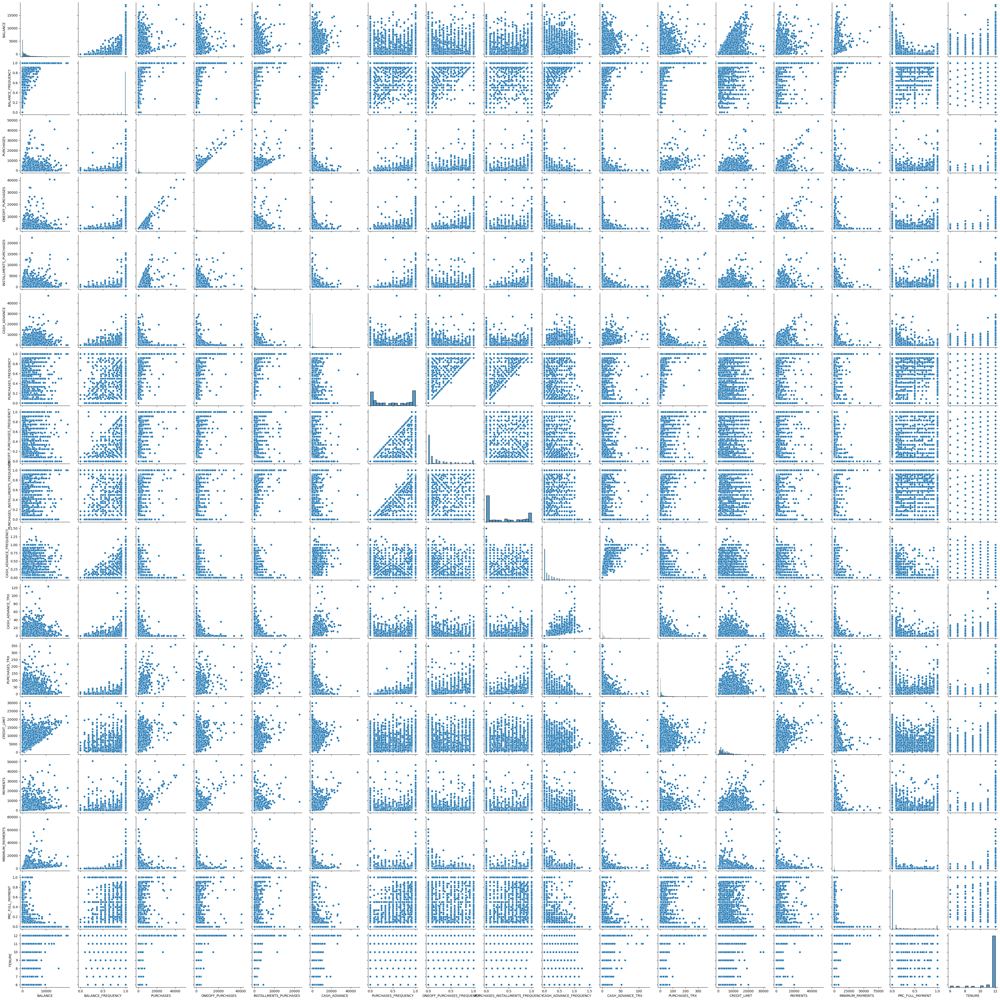

In [42]:
%matplotlib inline
sns.pairplot(df_dropCol)

<AxesSubplot:>

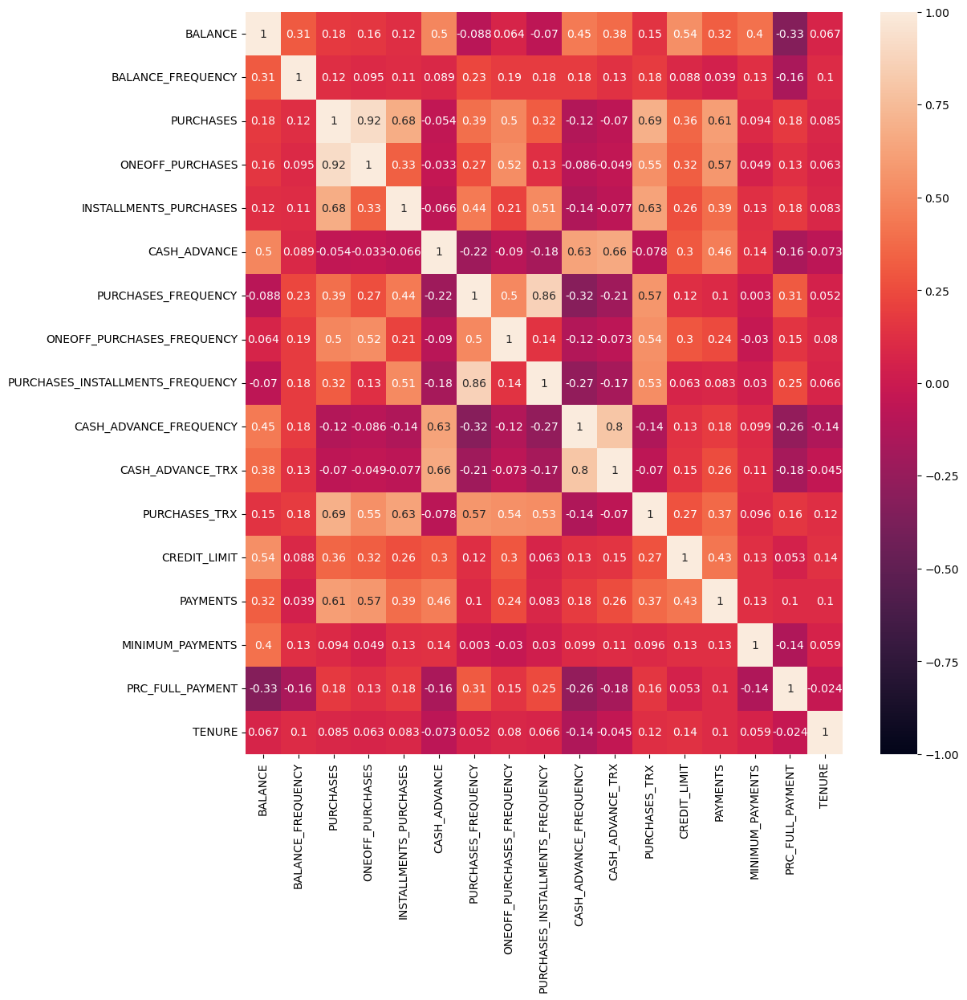

In [43]:
cor = df_dropCol.corr()
plt.figure(figsize=(12, 12))
sns.heatmap(cor, vmin = -1, vmax = 1, annot = True)

- 0.92 : purchase & one-off purchase
- 0.86 : purchase frequency & purchase installment frequency
- 0.80 : cash advance frequency & cash advance TRX
- 0.69 : purchase & purchase TRX
- 0.68 : purchase & installment purchase
- 0.66 : cash advance & cash advance TRX
- 0.63 : cash advance & cash advance frequency
- 0.61 : payment & purchase

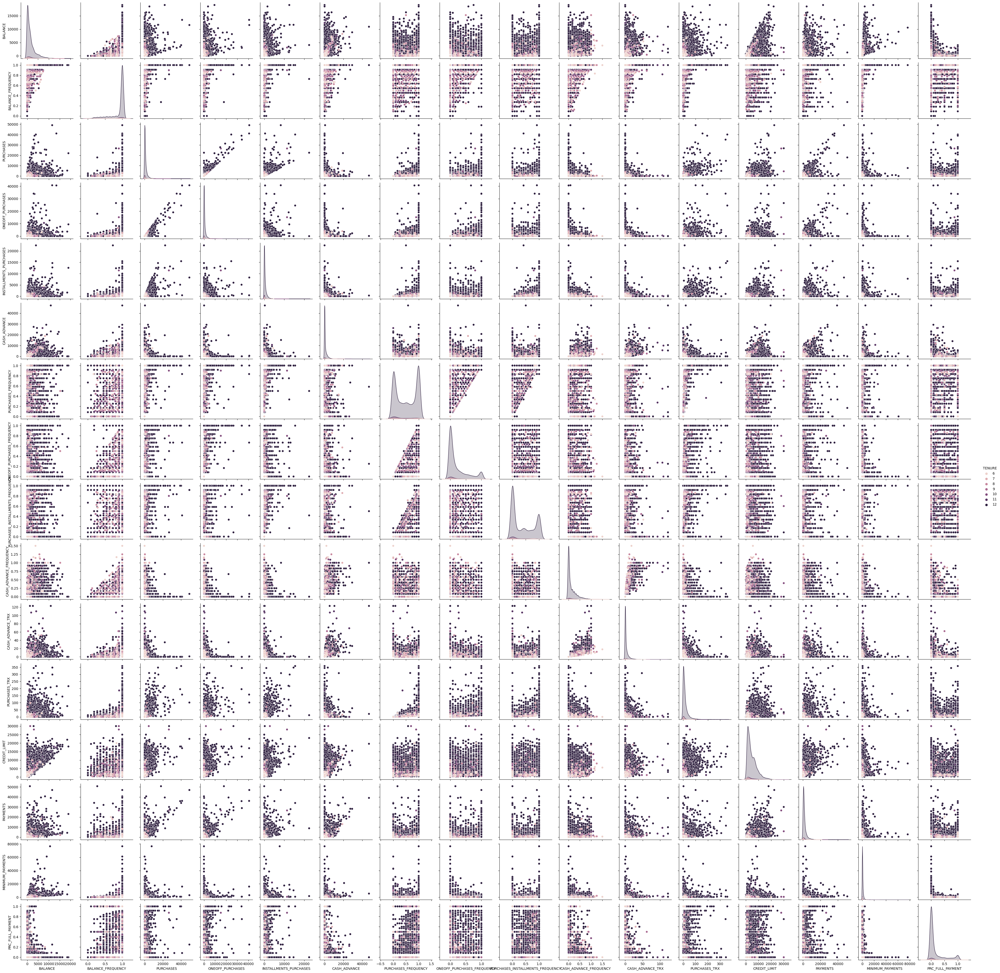

In [45]:
sns.pairplot(df_dropCol, hue = 'TENURE')

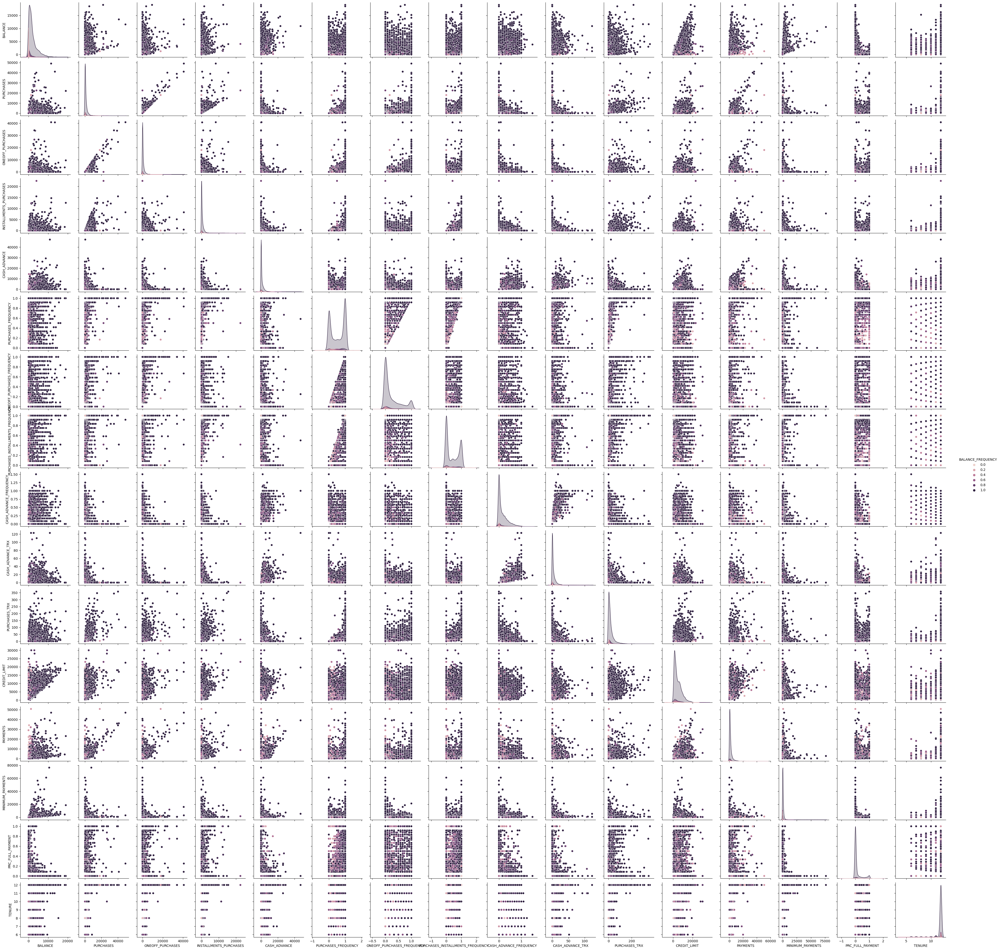

In [ ]:
sns.pairplot(df_dropCol, hue = 'BALANCE_FREQUENCY')

In [140]:
sns.pairplot(df_dropCol, hue = 'ONEOFF_PURCHASES_FREQUENCY')

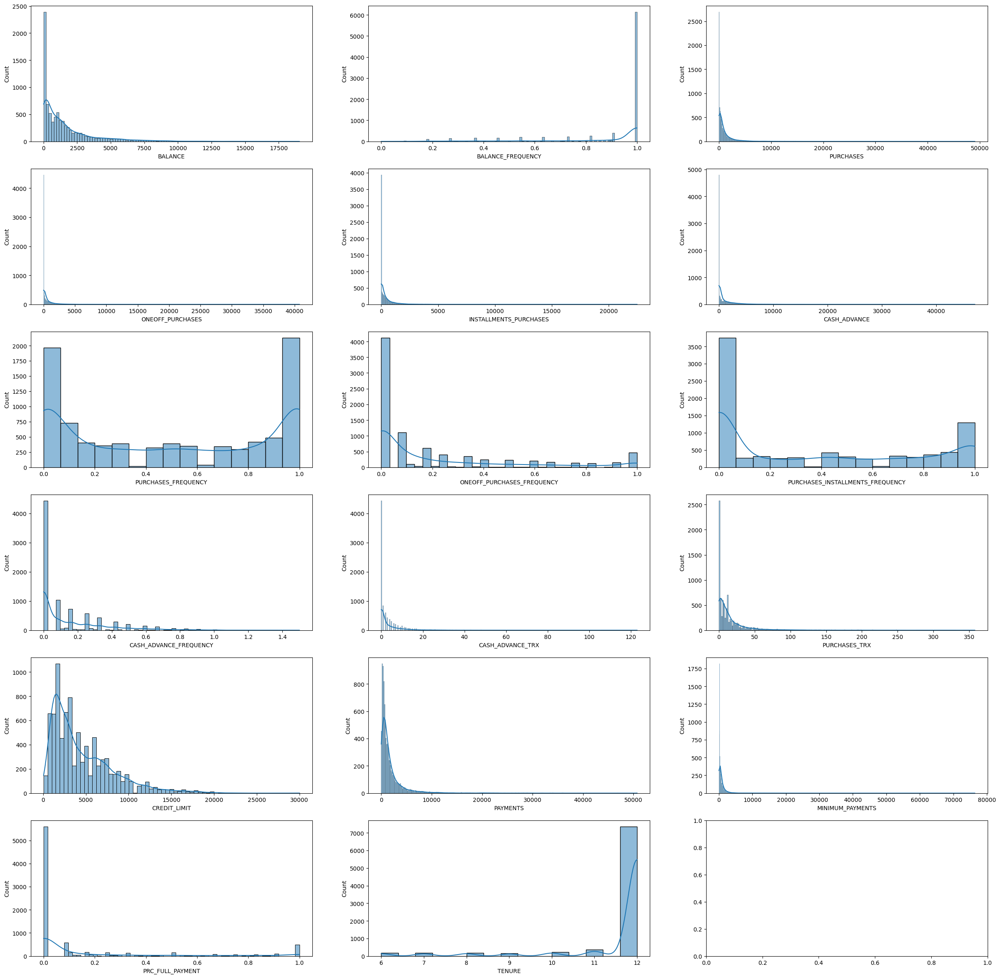

In [ ]:
colsNu = df_dropCol.columns
fig, ax = plt.subplots(6, 3, figsize=(30,30))

row = 0
for col in range(0, 17):
    if col % 3 == 0 and col != 0:
        row += 1
    sns.histplot(data = df_dropCol, x = colsNu[col], kde=True, ax=ax[row][col%3])
    
plt.show()

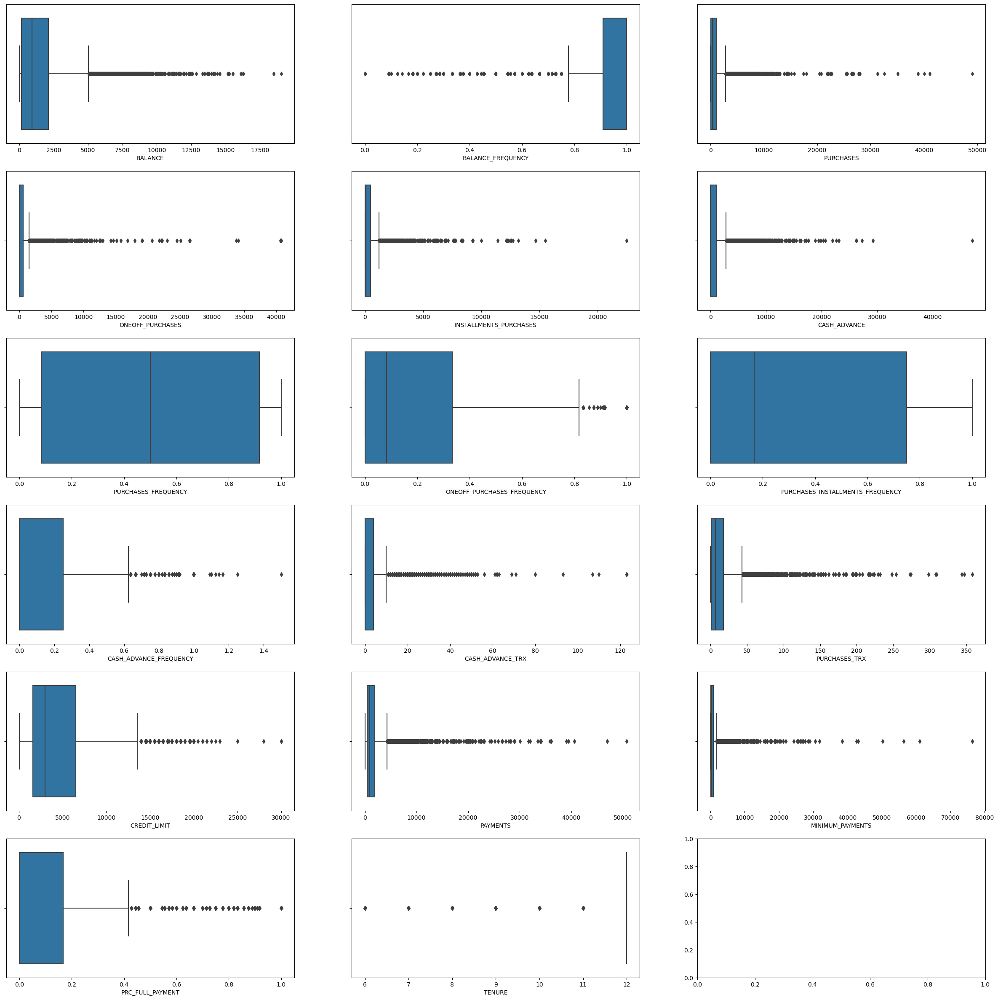

In [55]:
colsNu = df_dropCol.columns
fig, ax = plt.subplots(6, 3, figsize=(30,30))

row = 0
for col in range(0, 17):
    if col % 3 == 0 and col != 0:
        row += 1
    sns.boxplot(data = df_dropCol, x = colsNu[col], ax=ax[row][col%3])
    
plt.show()

---------------------------

### NONE Preprocessing

In [56]:
def findOutlier(dataframe, feature):
    Q1 = dataframe[feature].quantile(0.25)
    Q3 = dataframe[feature].quantile(0.75)
    IQR = Q3 - Q1
    lower_limit = Q1 - 1.5*IQR
    upper_limit = Q3 + 1.5*IQR       
    outlier = dataframe.index[(dataframe[feature] < lower_limit)|(dataframe[feature] > upper_limit)]
    return outlier

outlierAll = []
for feature in df_dropCol:
    outlierAll.extend(findOutlier(df_dropCol, feature))

print('All outlier in feature : ', len(set(outlierAll)))
df_removeCate = df_dropCol.drop(sorted(set(outlierAll)))
df_removeCate = df_removeCate.reset_index()
df_Pre0 = df_dropCol.drop(sorted(set(outlierAll)))
df_Pre0 = df_Pre0.reset_index()
df_Pre0 = df_Pre0.drop(columns='index')
df_Pre0

All outlier in feature :  5685


,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12
2,1823.652743,1.000000,436.20,0.00,436.20,0.000000,1.000000,0.000000,1.000000,0.000000,0,12,2300.0,679.065082,532.033990,0.000000,12
3,1014.926473,1.000000,861.49,661.49,200.00,0.000000,0.333333,0.083333,0.250000,0.000000,0,5,7000.0,688.278568,311.963409,0.000000,12
4,630.794744,0.818182,1492.18,1492.18,0.00,0.000000,0.250000,0.250000,0.000000,0.000000,0,6,2000.0,705.618627,155.549069,0.000000,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2946,981.286008,1.000000,1370.00,1370.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1400.0,596.685481,451.584847,0.000000,12
2947,87.026009,1.000000,605.52,0.00,605.52,0.000000,1.000000,0.000000,0.916667,0.000000,0,12,1500.0,511.637312,175.012705,0.000000,12
2948,16.428326,0.909091,441.50,124.70,316.80,0.000000,1.000000,0.166667,0.916667,0.000000,0,14,1000.0,482.547848,91.328536,0.333333,12
2949,67.377243,1.000000,295.00,0.00,295.00,0.000000,0.500000,0.000000,0.416667,0.000000,0,6,1000.0,245.689379,167.126034,0.300000,12


In [57]:
from sklearn.preprocessing import MinMaxScaler

min_max_scaler = MinMaxScaler()
scaleNu_pre = min_max_scaler.fit_transform(df_Pre0)
df_Pre = pd.DataFrame(scaleNu_pre, columns = df_Pre0.columns)
df_Pre

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,0.007925,0.0,0.038927,0.000000,0.078919,0.00000,0.166667,0.000000,0.083333,0.000000,0.0,0.046512,0.063670,0.044249,0.075968,0.000000,0.0
1,0.162988,1.0,0.006529,0.010688,0.000000,0.00000,0.083333,0.111111,0.000000,0.000000,0.0,0.023256,0.078652,0.156827,0.134510,0.000000,0.0
2,0.363787,1.0,0.177988,0.000000,0.360842,0.00000,1.000000,0.000000,1.000000,0.000000,0.0,0.279070,0.161049,0.157000,0.294234,0.000000,0.0
3,0.202354,1.0,0.351524,0.441871,0.165448,0.00000,0.333333,0.111111,0.250000,0.000000,0.0,0.116279,0.513109,0.159176,0.171862,0.000000,0.0
4,0.125676,0.0,0.608872,0.996767,0.000000,0.00000,0.250000,0.333333,0.000000,0.000000,0.0,0.139535,0.138577,0.163273,0.084887,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2946,0.195639,1.0,0.559017,0.915151,0.000000,0.00000,0.083333,0.111111,0.000000,0.000000,0.0,0.023256,0.093633,0.137538,0.249500,0.000000,0.0
2947,0.017132,1.0,0.247077,0.000000,0.500910,0.00000,1.000000,0.000000,0.916667,0.000000,0.0,0.279070,0.101124,0.117446,0.095709,0.000000,0.0
2948,0.003040,0.5,0.180150,0.083299,0.262069,0.00000,1.000000,0.222223,0.916667,0.000000,0.0,0.325581,0.063670,0.110574,0.049176,0.799999,0.0
2949,0.013210,1.0,0.120372,0.000000,0.244036,0.00000,0.500000,0.000000,0.416667,0.000000,0.0,0.139535,0.063670,0.054617,0.091324,0.719999,0.0


[1800.8225030978838, 1552.0015048582877, 1367.1510098174788, 1268.3004346902758, 1185.8635334831354, 1118.1151674300133, 1056.2746874582472, 1007.8959033225412, 961.382212050407]


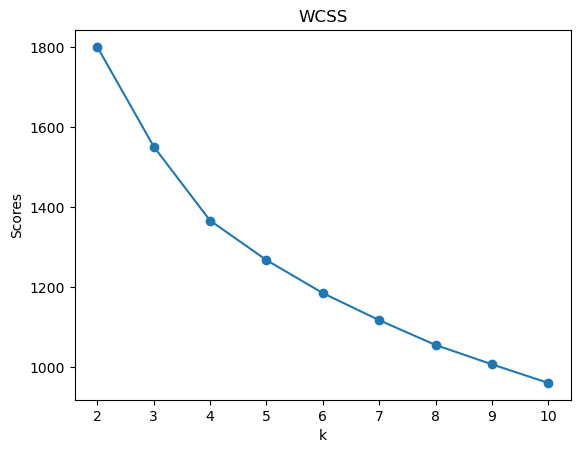

In [58]:
from sklearn.cluster import KMeans
from sklearn import metrics

Num_K = [i+1 for i in range(1, 10)]
WCSS = []

for k in Num_K:
  kmeans = KMeans(n_clusters = k, random_state = 1,)
  model = kmeans.fit(df_Pre)
  WCSS.append(model.inertia_)
print(WCSS)

plt.scatter(Num_K,WCSS )
plt.plot(Num_K,WCSS )
plt.title('WCSS')
plt.ylabel('Scores')
plt.xlabel('k')
plt.show()

[0.33180914728008526, 0.21966540138899948, 0.23254732048354548, 0.22216920554482955, 0.23038063637936554, 0.23185099072401147, 0.2076534002177206, 0.2067300582153045, 0.20380697125632996, 0.18382798982626064]


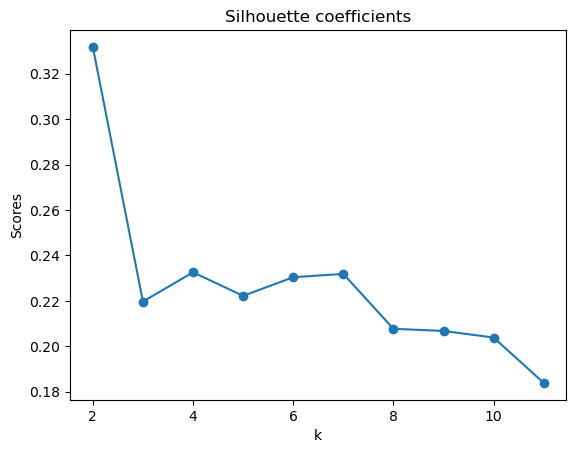

In [59]:
Num_K = [i+2 for i in range(0, 10)]
silhouette_coef = []

for k in Num_K:
  kmeans = KMeans(n_clusters=k, random_state=1,)
  model = kmeans.fit(df_Pre)
  labels = model.labels_
  silhouette_coef.append(metrics.silhouette_score(df_Pre, labels, metric='euclidean'))
print(silhouette_coef)

plt.scatter(Num_K,silhouette_coef)
plt.plot(Num_K,silhouette_coef)
plt.title('Silhouette coefficients')
plt.ylabel('Scores')
plt.xlabel('k')
plt.show()

In [126]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters = 3, random_state = 1)
model = kmeans.fit(df_Pre)

from sklearn import metrics
labels = model.labels_
labels

array([0, 0, 1, ..., 1, 0, 1])

In [128]:
df = pd.DataFrame(model.cluster_centers_,
                  index=pd.Index(['cluster1', 'cluster2', 'cluster3'], name='cluster'),
                  columns=pd.MultiIndex.from_product([['BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES', 'ONEOFF_PURCHASES',
       'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE', 'PURCHASES_FREQUENCY',
       'ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY',
       'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE_TRX', 'PURCHASES_TRX',
       'CREDIT_LIMIT', 'PAYMENTS', 'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT',
       'TENURE']]))
df.style

,"('BALANCE',)","('BALANCE_FREQUENCY',)","('PURCHASES',)","('ONEOFF_PURCHASES',)","('INSTALLMENTS_PURCHASES',)","('CASH_ADVANCE',)","('PURCHASES_FREQUENCY',)","('ONEOFF_PURCHASES_FREQUENCY',)","('PURCHASES_INSTALLMENTS_FREQUENCY',)","('CASH_ADVANCE_FREQUENCY',)","('CASH_ADVANCE_TRX',)","('PURCHASES_TRX',)","('CREDIT_LIMIT',)","('PAYMENTS',)","('MINIMUM_PAYMENTS',)","('PRC_FULL_PAYMENT',)","('TENURE',)"
cluster,,,,,,,,,,,,,,,,,
cluster1,0.208639,0.919965,0.127659,0.167968,0.051089,0.040635,0.243037,0.191635,0.100997,0.073879,0.061126,0.101225,0.216372,0.154130,0.227832,0.045415,0.000000
cluster2,0.187058,0.938406,0.294687,0.170436,0.386668,0.067639,0.873965,0.197608,0.805728,0.083851,0.086232,0.413284,0.237753,0.204425,0.246466,0.147877,0.000000
cluster3,0.363426,0.944575,0.039488,0.048461,0.020043,0.398836,0.076847,0.056473,0.033019,0.439859,0.465212,0.032937,0.231145,0.239539,0.333140,0.039669,0.000000


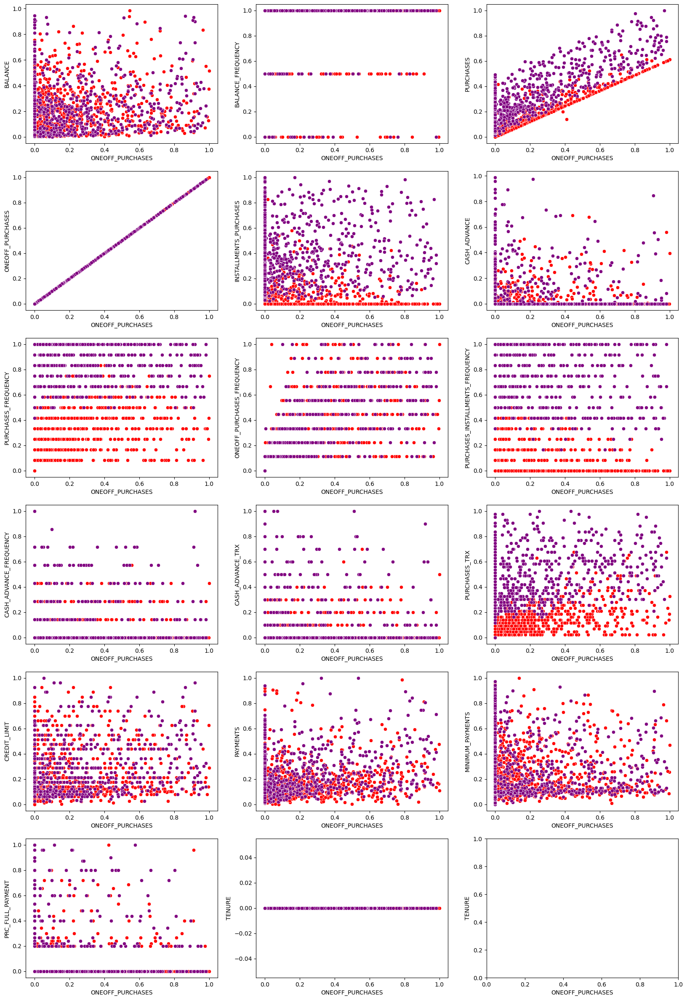

In [129]:
import warnings
warnings.simplefilter(action="ignore", category=FutureWarning)

label_0 = df_Pre[labels == 0]
label_1 = df_Pre[labels == 1]
cols = df_Pre.columns

fig, ax_arr = plt.subplots(6, 3, figsize=(20, 30))
row = 0
for col in range(0, 17):
    if col % 3 == 0 and col != 0:
        row += 1
    plt.ylabel(cols[col])
    plt.xlabel(cols[3])
    sns.scatterplot(label_0[cols[3]], label_0[cols[col]], color = 'red', ax = ax_arr[row][col%3])
    sns.scatterplot(label_1[cols[3]], label_1[cols[col]], color = 'purple', ax = ax_arr[row][col%3])

plt.show()

In [74]:
df_Pre2 = df_dropCol[['ONEOFF_PURCHASES_FREQUENCY','CASH_ADVANCE_TRX', 'PURCHASES_INSTALLMENTS_FREQUENCY', 'PRC_FULL_PAYMENT']]

[0.43857366171652196, 0.368423859318364, 0.39241608960410995, 0.40022374650929815, 0.38195886910186155, 0.39607697735952574, 0.4065002906442586, 0.3825952684004608, 0.366217880898906, 0.3804109310128275]


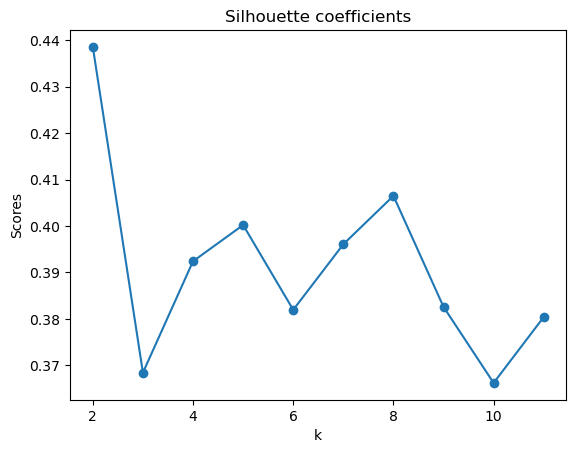

In [66]:
Num_K = [i+2 for i in range(0, 10)]
silhouette_coef = []

for k in Num_K:
  kmeans = KMeans(n_clusters=k, random_state=1,)
  model = kmeans.fit(df_Pre2)
  labels = model.labels_
  silhouette_coef.append(metrics.silhouette_score(df_Pre2, labels, metric='euclidean'))
print(silhouette_coef)

plt.scatter(Num_K,silhouette_coef)
plt.plot(Num_K,silhouette_coef)
plt.title('Silhouette coefficients')
plt.ylabel('Scores')
plt.xlabel('k')
plt.show()

In [67]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters = 2, random_state = 1)
model = kmeans.fit(df_Pre2)

from sklearn import metrics
labels = model.labels_
labels

array([0, 0, 1, ..., 1, 1, 1])

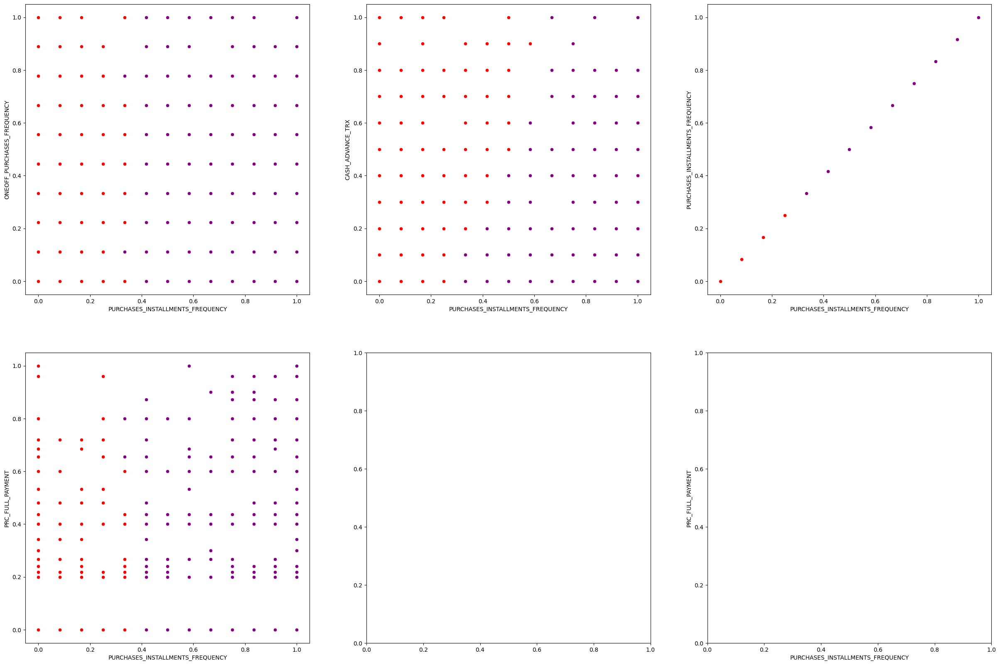

In [69]:
import warnings
warnings.simplefilter(action="ignore", category=FutureWarning)

label_0 = df_Pre2[labels == 0]
label_1 = df_Pre2[labels == 1]
label_2 = df_Pre2[labels == 2]
cols = df_Pre2.columns

fig, ax_arr = plt.subplots(2, 3, figsize=(30, 20))
row = 0
for col in range(0, 4):
    if col % 3 == 0 and col != 0:
        row += 1
    plt.ylabel(cols[col])
    plt.xlabel(cols[2])
    sns.scatterplot(label_0[cols[2]], label_0[cols[col]], color = 'red', ax = ax_arr[row][col%3])
    sns.scatterplot(label_1[cols[2]], label_1[cols[col]], color = 'purple', ax = ax_arr[row][col%3])

plt.show()

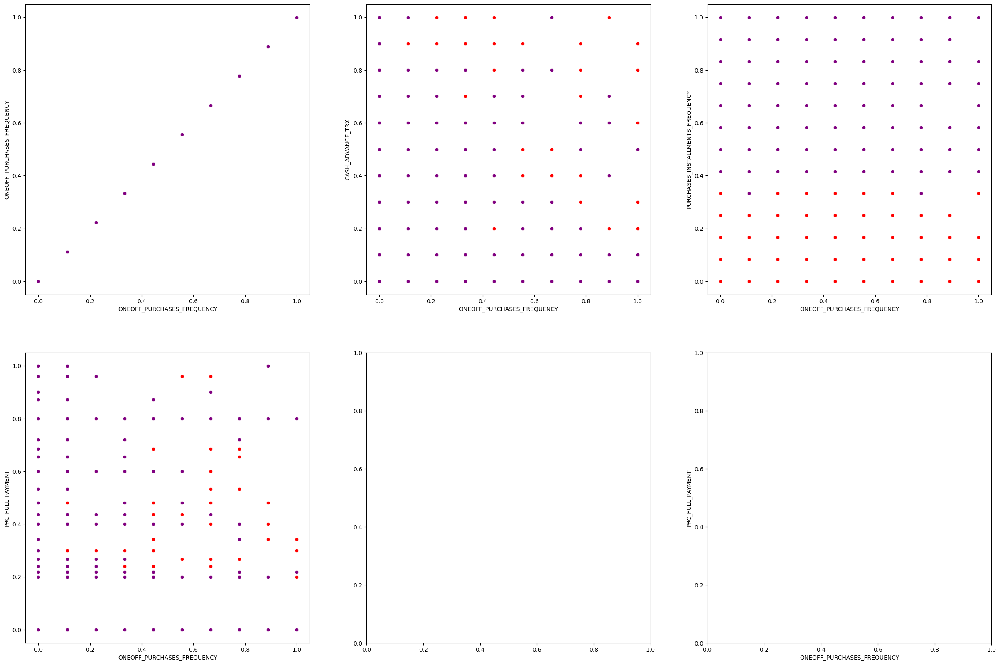

In [70]:
import warnings
warnings.simplefilter(action="ignore", category=FutureWarning)

label_0 = df_Pre2[labels == 0]
label_1 = df_Pre2[labels == 1]
cols = df_Pre2.columns

fig, ax_arr = plt.subplots(2, 3, figsize=(30, 20))
row = 0
for col in range(0, 4):
    if col % 3 == 0 and col != 0:
        row += 1
    plt.ylabel(cols[col])
    plt.xlabel(cols[0])
    sns.scatterplot(label_0[cols[0]], label_0[cols[col]], color = 'red', ax = ax_arr[row][col%3])
    sns.scatterplot(label_1[cols[0]], label_1[cols[col]], color = 'purple', ax = ax_arr[row][col%3])
    
plt.show()

In [130]:
df_Pre3 = df_dropCol[['BALANCE', 'PURCHASES_FREQUENCY', 'ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY', 'CASH_ADVANCE', 'CASH_ADVANCE_FREQUENCY']]

In [131]:
min_max_scaler = MinMaxScaler()
scaleNu_pre = min_max_scaler.fit_transform(df_Pre3)
df_Pre3 = pd.DataFrame(scaleNu_pre, columns = df_Pre3.columns)
df_Pre3

,BALANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE,CASH_ADVANCE_FREQUENCY
0,0.002148,0.166667,0.000000,0.083333,0.000000,0.000000
1,0.168169,0.000000,0.000000,0.000000,0.136685,0.166667
2,0.131026,1.000000,1.000000,0.000000,0.000000,0.000000
3,0.042940,0.083333,0.083333,0.000000,0.000000,0.000000
4,0.095038,0.666667,0.000000,0.583333,0.000000,0.000000
...,...,...,...,...,...,...
8631,0.000308,0.166667,0.166667,0.000000,0.000000,0.000000
8632,0.001496,1.000000,0.000000,0.833333,0.000000,0.000000
8633,0.001229,0.833333,0.000000,0.666667,0.000000,0.000000
8634,0.000707,0.000000,0.000000,0.000000,0.000776,0.111111


[0.5250720450683208, 0.5347939679252355, 0.4529886844583992, 0.48640004595615755, 0.4524111577491925, 0.4029282304098985, 0.385716438473343, 0.36838352174090727, 0.3676253236796732, 0.3611040116685711]


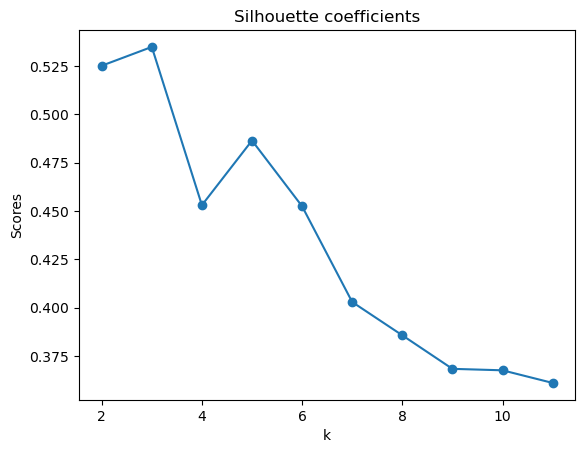

In [132]:
Num_K = [i+2 for i in range(0, 10)]
silhouette_coef = []

for k in Num_K:
  kmeans = KMeans(n_clusters=k, random_state=1,)
  model = kmeans.fit(df_Pre3)
  labels = model.labels_
  silhouette_coef.append(metrics.silhouette_score(df_Pre3, labels, metric='euclidean'))
print(silhouette_coef)

plt.scatter(Num_K,silhouette_coef)
plt.plot(Num_K,silhouette_coef)
plt.title('Silhouette coefficients')
plt.ylabel('Scores')
plt.xlabel('k')
plt.show()

In [133]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters = 3, random_state = 1)
model = kmeans.fit(df_Pre3)

from sklearn import metrics
labels = model.labels_
labels

array([0, 0, 2, ..., 1, 0, 2])

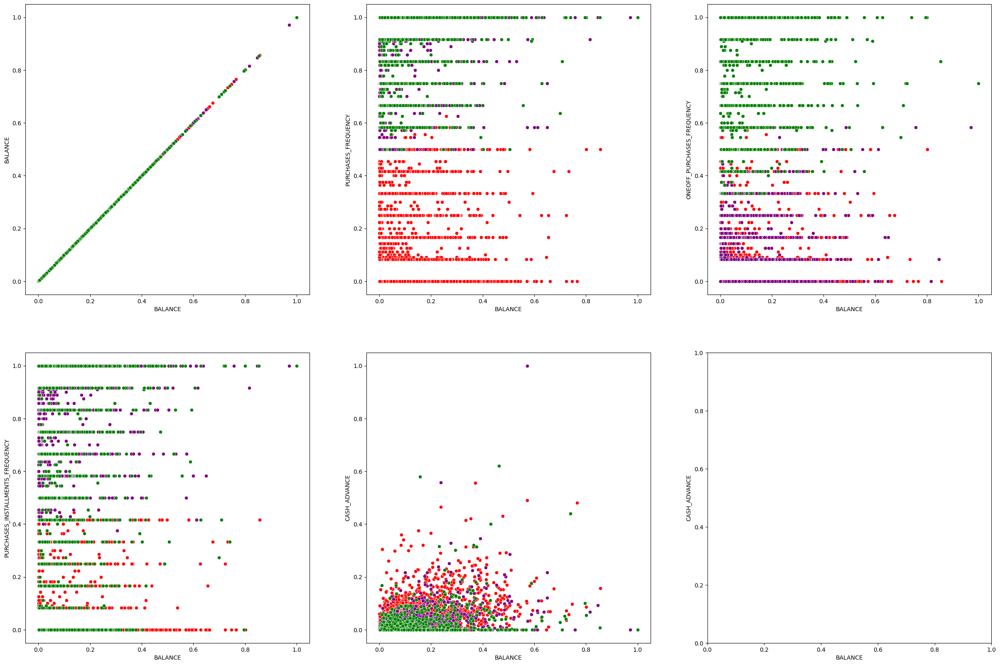

In [135]:
import warnings
warnings.simplefilter(action="ignore", category=FutureWarning)

label_0 = df_Pre3[labels == 0]
label_1 = df_Pre3[labels == 1]
label_2 = df_Pre3[labels == 2]
cols = df_Pre3.columns

fig, ax_arr = plt.subplots(2, 3, figsize=(30, 20))
row = 0
for col in range(0, 5):
    if col % 3 == 0 and col != 0:
        row += 1
    plt.ylabel(cols[col])
    plt.xlabel(cols[0])
    sns.scatterplot(label_0[cols[0]], label_0[cols[col]], color = 'red', ax = ax_arr[row][col%3])
    sns.scatterplot(label_1[cols[0]], label_1[cols[col]], color = 'purple', ax = ax_arr[row][col%3])
    sns.scatterplot(label_2[cols[0]], label_2[cols[col]], color = 'green', ax = ax_arr[row][col%3])
    
plt.show()

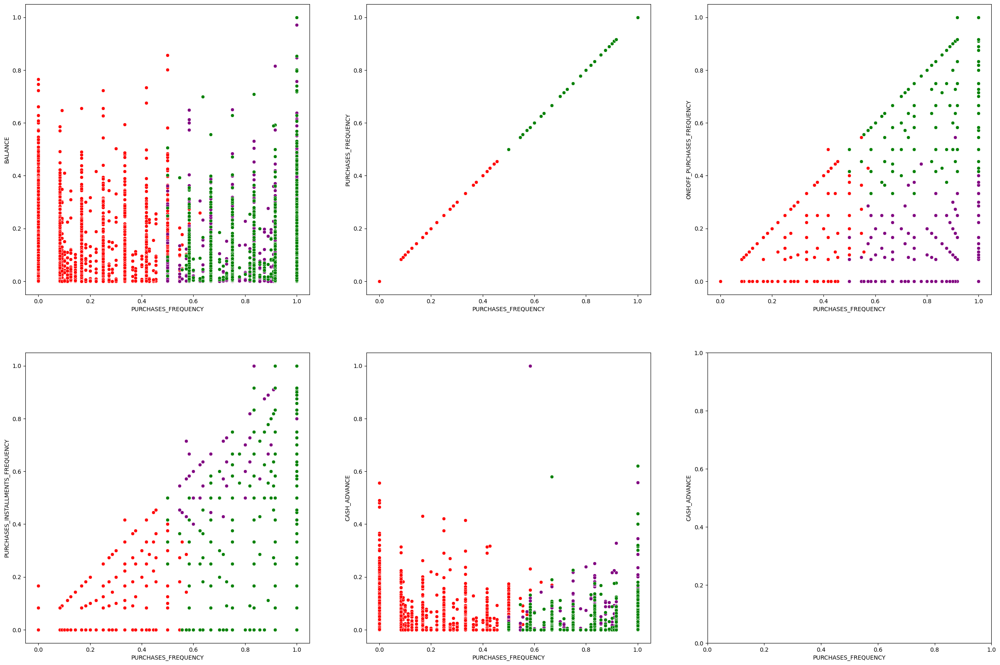

In [136]:
import warnings
warnings.simplefilter(action="ignore", category=FutureWarning)

label_0 = df_Pre3[labels == 0]
label_1 = df_Pre3[labels == 1]
label_2 = df_Pre3[labels == 2]
cols = df_Pre3.columns

fig, ax_arr = plt.subplots(2, 3, figsize=(30, 20))
row = 0
for col in range(0, 5):
    if col % 3 == 0 and col != 0:
        row += 1
    plt.ylabel(cols[col])
    plt.xlabel(cols[1])
    sns.scatterplot(label_0[cols[1]], label_0[cols[col]], color = 'red', ax = ax_arr[row][col%3])
    sns.scatterplot(label_1[cols[1]], label_1[cols[col]], color = 'purple', ax = ax_arr[row][col%3])
    sns.scatterplot(label_2[cols[1]], label_2[cols[col]], color = 'green', ax = ax_arr[row][col%3])
    
plt.show()

In [138]:
df = pd.DataFrame(model.cluster_centers_,
                  index=pd.Index(['cluster1', 'cluster2', 'cluster3'], name='cluster'),
                  columns=pd.MultiIndex.from_product([['BALANCE', 'PURCHASES_FREQUENCY', 'ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY', 'CASH_ADVANCE', 'CASH_ADVANCE_FREQUENCY']]))
df.style

,"('BALANCE',)","('PURCHASES_FREQUENCY',)","('ONEOFF_PURCHASES_FREQUENCY',)","('PURCHASES_INSTALLMENTS_FREQUENCY',)","('CASH_ADVANCE',)","('CASH_ADVANCE_FREQUENCY',)"
cluster,,,,,,
cluster1,0.091612,0.145896,0.081150,0.062825,0.029037,0.126120
cluster2,0.063712,0.877050,0.105054,0.826692,0.011443,0.048472
cluster3,0.098911,0.888034,0.797469,0.473104,0.014103,0.064385
